# Population Tessellation

In the last two notebooks, we worked on how to determine the population of any given
area using the raster dataset GHS-POP (Global Human Settlement Population Layer) for
the P2023 release. As our goal is to repeatedly determine the population density of
LTNs, we want to have an effective way to do this. As the LTNs are made up of
subgraphs of our road network, we showed a way to tessellate using roads.

_A tessellation is..._
... a collection of plane figures that fills the plane with no overlaps and no gaps.
In geometry and mathematics tilings are often done with repeating patterns or shapes.
Voronoi tessellations are usually aperiodic.

In [ ]:
import matplotlib.pyplot as plt
from matplotlib._color_data import CSS4_COLORS
import numpy as np
from scipy.spatial import Voronoi, voronoi_plot_2d
import osmnx as ox
from superblockify import get_edge_cells, get_ghsl, resample_load_window
from rasterstats import zonal_stats
from rasterio.features import shapes
import geopandas as gpd
from shapely.geometry import shape
from shapely import STRtree

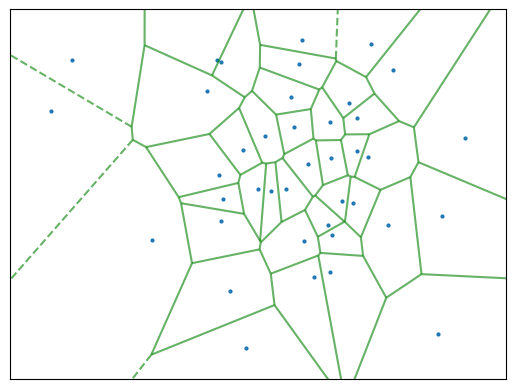

In [4]:
# Generate Example Voronoi Tessellation
np.random.seed(1671593280)
points = np.random.multivariate_normal(mean=[0, 0], cov=[[1, 0], [0, 0.6]], size=40)
vor = Voronoi(points)
fig = voronoi_plot_2d(vor, figsize=(5, 4), show_vertices=False, line_colors='green',
                      line_width=1.5, line_alpha=0.6, point_size=4)
plt.tick_params(axis='both', which='both', bottom=False, top=False, labelbottom=False,
                right=False, left=False, labelleft=False)

To keep the code effective, we renounce calculating the Voronoi tessellation for each
partition of the road network. Instead, tessellate the whole road network once using
roads and calculate the population and area of each road cell. Then, we can use this
information to determine the population density of each LTN repeatedly.

There are two approaches we want to consider integrating the population raster data over
the road cells. The first approach is to use up-sampled raster data, as we did before.
The second approach is to polygonize the raster data and intersect the road cells with
it. For both, we need to consider used memory and computation time. Loading in a big
city with an up-sampled raster dataset can take a lot of time and memory, but it
needs to be up-sampled to reach better population approximations. Calculating
intersections between polygons could be computationally heavy.

## Data Preparation

First, let's get an example road network and tessellate it. We are Using _La Crosse,
Wisconsin_ as an example. By the Native American Neshnabé/Potawatomi, it is called
_ensewaksak_.
The working CRS is the World Mollweide projection, as it is an equal-area projection,
and the GHS-POP raster data is in this projection. But the edge cells need to be
calculated in the local CRS, to avoid distortion.

In [21]:
lc_graph = ox.graph_from_place("La Crosse, La Crosse County, Wisconsin, United "
                                 "States",
                            network_type="drive")
lc_graph = ox.project_graph(lc_graph)  # to local UTM zone
# Get Road Cells
lc_road_cells = get_edge_cells(lc_graph)
# Project to World Mollweide
lc_road_cells = lc_road_cells.to_crs("World Mollweide")

2023-06-13 16:36:10,710 |     INFO | tessellation.py:96 | Calculating edge cells for graph with 4747 edges.
2023-06-13 16:36:17,464 |    DEBUG | tessellation.py:130 | Prepared 37647 points. Creating Voronoi tessellation.
2023-06-13 16:36:18,036 |    DEBUG | tessellation.py:134 | Reconstructing edge cells.
2023-06-13 16:36:20,381 |     INFO | tessellation.py:139 | Tessellated 2550 edge cells in 0:00:09.


In [22]:
# random color of CSS4_COLORS
lc_road_cells["color_name"] = np.random.choice(list(CSS4_COLORS.keys()), size=len(lc_road_cells))
lc_road_cells.explore(color="color_name", style_kwds={"color": "black", "opacity": 0.5,
                                                   "weight": 1}, zoom_start=14)

<Axes: >

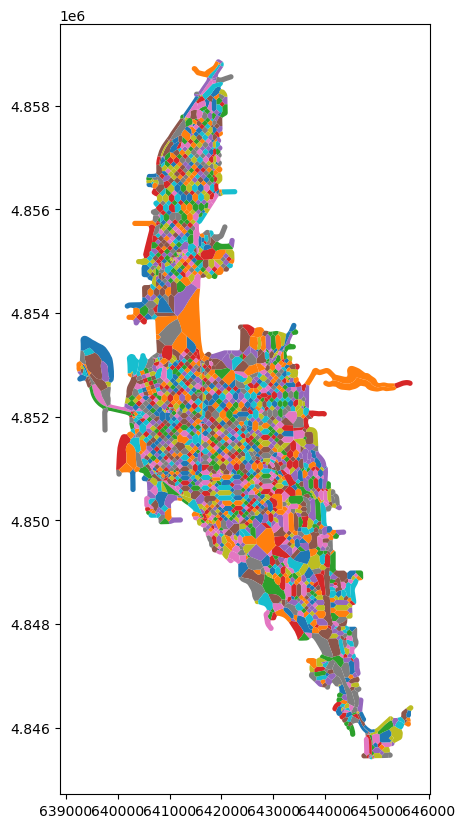

In [80]:
lc_road_cells.to_crs(lc_graph.graph["crs"]).plot(figsize=(10, 10), column="geometry",
                                                 cmap="tab20", edgecolor="black",
                                                 alpha=0.5)

We need to get the GHS-POP raster data for the area of interest. For that we can
use the `get_ghsl` function from the `superblockify` package. It needs a bounding box
of the whole are in Mollweide projection, and it will download the raster data and
return the file path(s) to the raster data. The raster data is in GeoTIFF format.
For that, we take the union of all road cells and get the bounding box of it. When
looking at the union, the _skewness_ of our projection is visible.

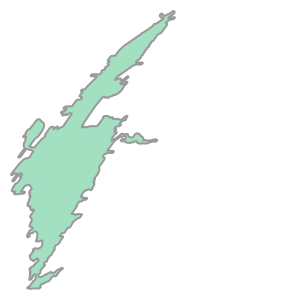

In [25]:
lc_road_cells.unary_union

In [26]:
lc_bbox = lc_road_cells.unary_union.bounds
lc_ghsl = get_ghsl(lc_bbox)

2023-06-13 16:40:41,441 |     INFO | ghsl.py:120 | Using the full GHSL raster at /home/carlsonb/sciebo/Physics/22_23-MA_Thesis/Code/Superblockify/superblockify/../data/ghsl/GHS_POP_E2025_GLOBE_R2023A_54009_100_V1_0.tif.


## Up-sampled Raster Data

Try to load the raster data inside the bounding box into memory and scale up by a
factor of 10. The original cells are 100m x 100m, so the up-sampled cells are 10m x 10m.
For that, we use the `resample_load_window` function from the `superblockify` package.


In [27]:
lc_ghsl_upsampled, lc_affine_upsampled = resample_load_window(file=lc_ghsl,
                                                              resample_factor=10,
                                                              window=lc_road_cells)
# The resampling strategy for upscaling is `nearest`, so to conserve the population
# values, we need to divide the population values by the resample factor squared.
lc_ghsl_upsampled /= 10 ** 2

Now, we can use the `zonal_stats` function from the `rasterstats` package to calculate
the population and area of each road cell. Just like we did in the Population Density notebook.

In [28]:
lc_zonal_stats = zonal_stats(lc_road_cells, lc_ghsl_upsampled,
                             affine=lc_affine_upsampled,
                             stats=["sum"], nodata=0, all_touched=False)
lc_zonal_stats

[{'sum': 27.736934700012206},
 {'sum': 57.54388454794884},
 {'sum': 9.441585874557497},
 {'sum': 83.49477727890014},
 {'sum': 42.04639352798462},
 {'sum': 79.51573175430298},
 {'sum': 13.180007709264755},
 {'sum': None},
 {'sum': 0.38890042066574093},
 {'sum': 1.3796970127103851},
 {'sum': 10.770762196704744},
 {'sum': None},
 {'sum': None},
 {'sum': 0.02716662362217903},
 {'sum': 0.005330151841044426},
 {'sum': None},
 {'sum': 9.46821258544922},
 {'sum': 10.082703161239625},
 {'sum': 7.76932455688715},
 {'sum': 6.3154727077484125},
 {'sum': 3.4376431417465207},
 {'sum': None},
 {'sum': 9.60442176580429},
 {'sum': 0.6826372146606445},
 {'sum': 11.02046928524971},
 {'sum': 3.827122821807861},
 {'sum': 27.360875908420418},
 {'sum': 7.638628711700438},
 {'sum': 20.161720242500305},
 {'sum': 1.9031098937988282},
 {'sum': 11.238288698196413},
 {'sum': 32.4234875869751},
 {'sum': 24.966256742477412},
 {'sum': 4.504443483352661},
 {'sum': 14.097531232833862},
 {'sum': 5.742001433372497},
 {'s

In [29]:
# Write to lc_road_cells
lc_road_cells["population_sampled_10"] = [zs_cell["sum"] for zs_cell in lc_zonal_stats]
# pop density in people per square meter
lc_road_cells["pop_density_sampled_10"] = lc_road_cells["population_sampled_10"] / \
                                          lc_road_cells["geometry"].area
# Plot with colormap
lc_road_cells.explore(column="pop_density_sampled_10")

Here we also see cells with a population density of 0. This is the case on Barron Island
in the Mississippi River, as it should, or industrial areas. For especially small
cells, the uncertainty introduced by the raster is higher in comparison to the absolute
population. This effect might be visible here, when specifically looking at the
cells, but when dissolving the cells into LTNs, the effect will compensate itself.

## Polygonized Raster Data

For this approach first, we need to polygonize the raster data. For that, `rasterio`
has the `features.shapes` function.

Then we will use a :class:`shapely.STRtree` to intersect the road cells with
the polygons. The :class:`shapely.STRtree` is a spatial index, which can be used to
efficiently query the intersection of two geometries. From the tesselation we will
build up the spatial index and query the intersection of the road cells with the
polygons. This way we will distribute the population of the raster to the road cells,
weighted by the intersecting fraction.

In [30]:
# raster, no upsample
lc_ghsl_unsampled, lc_affine_unsampled = resample_load_window(file=lc_ghsl, window=lc_road_cells)
# convert to float32
lc_ghsl_unsampled = lc_ghsl_unsampled.astype(np.float32)

In [31]:
lc_shapes = [
    {'population': pop, 'geometry': shp}
    for _, (shp, pop) in enumerate(shapes(lc_ghsl_unsampled,
                                          transform=lc_affine_unsampled))
    if pop > 0
]
lc_ghsl_polygons = gpd.GeoDataFrame(
    geometry=[shape(geom["geometry"]) for geom in lc_shapes],
    data=[geom["population"] for geom in lc_shapes],
    columns=["population"],
    crs="World Mollweide"
)
lc_ghsl_polygons.explore(column="population", vmax=260)

One cell has a population of over 500 people; this is why we set the cutoff to 260.
Looking at the cell on a map, a number this high is implausible. For our analysis, we
will provide a sanity-check, where one can set a cutoff. But other than that ,this is
a problem of the GHS-POP data. In general, the data quality of the GHS-POP dataset is
very high and well suited for our evaluation, in spite of this outlier.

Let us build up the spatial index of the tesselation.

In [32]:
lc_road_cells_sindex = STRtree(lc_road_cells.geometry)

In [56]:
# Distributing the population over the road cells
# initialize population column
lc_road_cells["population_polygons"] = 0
# Query all geometries at once lc_road_cells_sindex.query(lc_ghsl_polygons["geometry"])
lc_road_cells_loc_pop = lc_road_cells.columns.get_loc("population_polygons")
for pop_cell_idx, road_cell_idx in lc_road_cells_sindex.query(
        lc_ghsl_polygons["geometry"]).T:
    # get the intersection of the road cell and the polygon
    # print(road_cell_idx, pop_cell_idx)
    # print(lc_road_cells.iloc[road_cell_idx]["geometry"].area)
    intersection = lc_road_cells.iloc[road_cell_idx]["geometry"].intersection(
        lc_ghsl_polygons.iloc[pop_cell_idx]["geometry"]
    )
    # print(
    #     f"Index of lc_road_cells at {road_cell_idx}: {lc_road_cells.index[road_cell_idx]}")
    # get the population of the polygon
    population = lc_ghsl_polygons.iloc[pop_cell_idx]["population"]
    # query by row number of lc_road_cells, as lc_road_cells has different index
    lc_road_cells.iat[
        road_cell_idx, lc_road_cells_loc_pop] += population * intersection.area / \
                                                 lc_ghsl_polygons.iloc[pop_cell_idx][
                                                     "geometry"].area

In [49]:
lc_road_cells

,geometry,color_name,population_sampled_10,pop_density_sampled_10,population_polygons,pop_density_polygons,pop_density_diff
"((231348547, 231348552, 0), (231348552, 231348547, 0))","POLYGON ((-7464180.271 5207477.738, -7464162.4...",royalblue,27.736935,0.002579,19.682047,0.001830,0.001830
"((231348547, 231383681, 0), (231383681, 231348547, 0))","POLYGON ((-7464380.038 5207489.182, -7464380.2...",rosybrown,57.543885,0.001040,13.711644,0.000248,0.000248
"((231348547, 231383683, 0), (231383683, 231348547, 0))","POLYGON ((-7464382.094 5207354.681, -7464381.4...",palevioletred,9.441586,0.000614,11.519765,0.000750,0.000750
"((231348552, 231383688, 0), (231383688, 231348552, 0))","POLYGON ((-7464446.114 5206928.516, -7464453.7...",lightslategrey,83.494777,0.001552,18.395186,0.000342,0.000342
"((231348552, 231390097, 0), (231390097, 231348552, 0))","POLYGON ((-7464059.528 5207490.791, -7464062.4...",gray,42.046394,0.001601,12.472527,0.000475,0.000475
...,...,...,...,...,...,...,...
"((10827924801, 7154271033, 0), (7154271033, 10827924801, 0))","POLYGON ((-7464260.716 5210676.366, -7464249.9...",teal,20.335061,0.001723,13.506726,0.001145,0.001145
"((10827924818, 10827924797, 0),)","POLYGON ((-7463895.877 5210973.072, -7463895.9...",dodgerblue,37.422338,0.008283,36.202114,0.008013,0.008013
"((10861858010, 231418870, 0), (231418870, 10861858010, 0))","POLYGON ((-7461662.093 5215065.295, -7461657.3...",silver,3.548469,0.000373,13.974023,0.001467,0.001467
"((10861858011, 231371745, 0), (231371745, 10861858011, 0))","POLYGON ((-7461784.877 5214967.606, -7461767.9...",gray,4.513821,0.000657,8.005509,0.001165,0.001165


In [57]:
# pop density in people per square meter
lc_road_cells["pop_density_polygons"] = lc_road_cells["population_polygons"] / \
                                        lc_road_cells["geometry"].area
# Plot with colormap
lc_road_cells.explore(column="pop_density_polygons")  #, vmax=250)

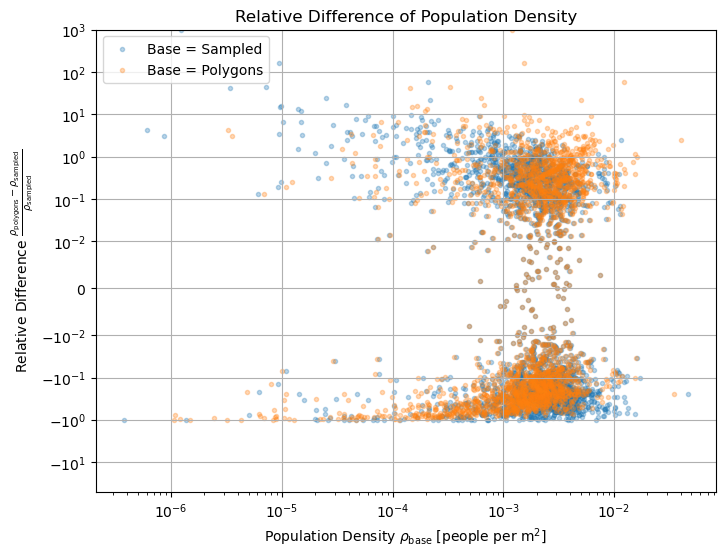

In [71]:
# Relative difference between the two approaches
lc_road_cells["pop_density_diff_samp"] = (lc_road_cells["pop_density_polygons"] -
                                          lc_road_cells["pop_density_sampled_10"]) / \
                                         lc_road_cells["pop_density_sampled_10"]
lc_road_cells["pop_density_diff_poly"] = (lc_road_cells["pop_density_polygons"] -
                                          lc_road_cells["pop_density_sampled_10"]) / \
                                         lc_road_cells["pop_density_polygons"]
# Plot scatter pop density difference vs. pop density
fig, ax = plt.subplots(figsize=(8, 6))
ax.scatter(lc_road_cells["pop_density_sampled_10"],
           lc_road_cells["pop_density_diff"], marker=".", alpha=0.3, color="C0",
           label=r"Base = Sampled")
ax.scatter(lc_road_cells["pop_density_polygons"],
           lc_road_cells["pop_density_diff"], marker=".", alpha=0.3, color="C1",
           label=r"Base = Polygons")
ax.set_xscale("log")
# y symlog, starting from 0.01
ax.set_yscale("symlog", linthresh=0.01)
ax.set_xlabel(r"Population Density $\rho_\mathrm{base}$ [people per $\mathrm{m}^2$]")
ax.set_ylabel(r"Relative Difference $\frac{\rho_\mathrm{polygons} - "
              r"\rho_\mathrm{sampled}}{\rho_\mathrm{sampled}}$")
ax.set_title("Relative Difference of Population Density")
ax.grid()
# show legend
ax.legend()
plt.show()

This plot shows the relative difference between the two approaches.
We see the second approach, weighing the population by the intersecting fraction,
does never underestimate the raster-based approach by less than 1% (cut-off at $-10^{0}$).
The average relative difference is around $\pm 2 \times 10^{-1} \approx \pm 0
.2\%$. For smaller population densities, the relative difference is larger, but
the absolute difference is smaller. Again, this effect might be visible for single
cells, but when dissolving the cells into LTNs, the effect will compensate itself.

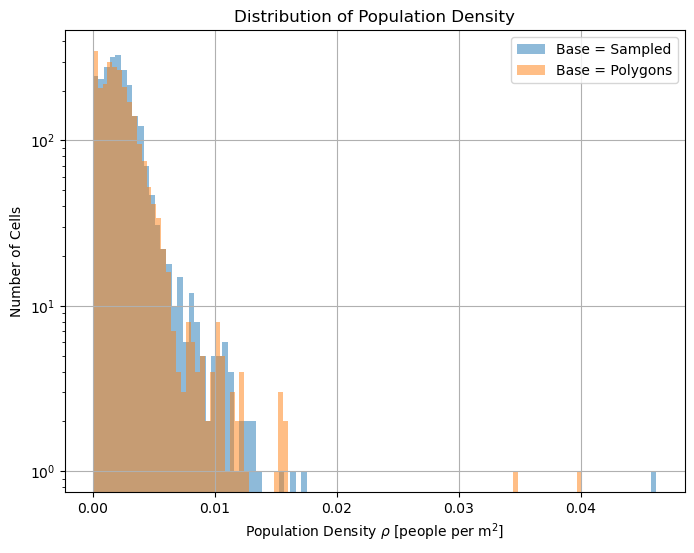

In [74]:
# Distribution of the densities, next to each other
fig, ax = plt.subplots(figsize=(8, 6))
ax.hist(lc_road_cells["pop_density_sampled_10"], bins=100, alpha=0.5, color="C0",
        label=r"Base = Sampled")
ax.hist(lc_road_cells["pop_density_polygons"], bins=100, alpha=0.5, color="C1",
        label=r"Base = Polygons")
# ax.set_xscale("log")
ax.set_yscale("log")
ax.set_xlabel(r"Population Density $\rho$ [people per $\mathrm{m}^2$]")
ax.set_ylabel(r"Number of Cells")
ax.set_title("Distribution of Population Density")
ax.grid()
ax.legend()
plt.show()

We will settle for the second approach, as it is a cleaner approach, not needing
the data up-sampling. This can be useful for large cities.